In [1]:
#imports
import astropy.units as u
import numpy as np
import gala.potential as gp
import gala.dynamics as gd
from gala.dynamics import mockstream as ms
from gala.units import galactic
from astropy.coordinates import SkyCoord, Distance
#import popsims
import matplotlib.pyplot as plt
#%matplotlib notebook
from tqdm import tqdm
import HSS
plt.style.use('dark_background')

In [2]:
import matplotlib as mpl
mpl.rc('xtick', labelsize=14) 
mpl.rc('ytick', labelsize=14) 
font = {#'family' : 'Helvetica',
        'size'   : 14}

In [3]:
path_plot = '/users/caganze/research/stellarstreams/figures/streamssims'

In [4]:
#use NFW POTENTIAL BECAUSE THE HALO? 
import astropy.coordinates as coord
_ = coord.galactocentric_frame_defaults.set('v4.0')

#chat
#pot = gp.NFWPotential.from_circular_velocity(v_c=220*u.km/u.s, r_s=15*u.kpc, units=galactic)
pot=gp.MilkyWayPotential()#
#CONSTRUCT A HAMILTONIAN
H = gp.Hamiltonian(pot)

In [5]:
def generate_stream(mass, prog_w0, dt=8 * u.Myr, nsteps=1000 ):
    df = ms.FardalStreamDF()
    prog_mass = mass * u.Msun
    gen = ms.MockStreamGenerator(df, H)
    stream, prog = gen.run(prog_w0, prog_mass ,dt=dt, n_steps=nsteps)
    return stream, prog
    

In [6]:
def get_stream_aftert(mass, t, pos0, vel0):
    nsteps=1000
    dt=(t/nsteps)*u.Gyr.to(u.Myr)
    prog_w0 = gd.PhaseSpacePosition(pos=pos ,
                                        vel=vel)
    return generate_stream(mass, prog_w0, dt=dt * u.Myr, nsteps=nsteps)[0]
    

In [7]:
from tqdm import tqdm
import itertools

In [8]:
(([-10, 3, 1.])*u.kpc/u.Gyr).to(u.km/u.s)

<Quantity [-9.77792222,  2.93337667,  0.97779222] km / s>

In [9]:
#pick a phase space position
#pick a phase space position
poss=[([8.3, 5., -700.])*u.kpc, ([-10, 15., -700.])*u.kpc, ([0., -5., -700.])*u.kpc]
vels=[([-10, 8, 100.])*u.kpc/u.Gyr, ([54, -3, 1.])*u.kpc/u.Gyr, ([-5, 40, 19.])*u.kpc/u.Gyr]
masses=[1e4, 1e5, 1e7]

stream_dict={}
for perm in tqdm(list(itertools.product(*[poss, vels, masses]))):

        pos,  vel, mass=perm
        prog_w0 = gd.PhaseSpacePosition(pos=pos ,
                                        vel=vel)
        key='stream_pos{}_vel{}_mass{}'.format(pos.value,  vel.value, mass)

        stream, pr= generate_stream(mass,  prog_w0)
        
        stream_dict.update({key: stream})


100%|██████████| 27/27 [00:21<00:00,  1.28it/s]


In [10]:
for k in stream_dict.keys():
    print (k)

stream_pos[   8.3    5.  -700. ]_vel[-10.   8. 100.]_mass10000.0
stream_pos[   8.3    5.  -700. ]_vel[-10.   8. 100.]_mass100000.0
stream_pos[   8.3    5.  -700. ]_vel[-10.   8. 100.]_mass10000000.0
stream_pos[   8.3    5.  -700. ]_vel[54. -3.  1.]_mass10000.0
stream_pos[   8.3    5.  -700. ]_vel[54. -3.  1.]_mass100000.0
stream_pos[   8.3    5.  -700. ]_vel[54. -3.  1.]_mass10000000.0
stream_pos[   8.3    5.  -700. ]_vel[-5. 40. 19.]_mass10000.0
stream_pos[   8.3    5.  -700. ]_vel[-5. 40. 19.]_mass100000.0
stream_pos[   8.3    5.  -700. ]_vel[-5. 40. 19.]_mass10000000.0
stream_pos[ -10.   15. -700.]_vel[-10.   8. 100.]_mass10000.0
stream_pos[ -10.   15. -700.]_vel[-10.   8. 100.]_mass100000.0
stream_pos[ -10.   15. -700.]_vel[-10.   8. 100.]_mass10000000.0
stream_pos[ -10.   15. -700.]_vel[54. -3.  1.]_mass10000.0
stream_pos[ -10.   15. -700.]_vel[54. -3.  1.]_mass100000.0
stream_pos[ -10.   15. -700.]_vel[54. -3.  1.]_mass10000000.0
stream_pos[ -10.   15. -700.]_vel[-5. 40. 19.]_mas

In [11]:
def plot_streams(st, axes, plot_icrs=False,  plot_3d=False):
    #len of axes must be the same as len of stream
    for a, s in zip(axes, st):
        a.scatter(s.cartesian.x/s.cartesian.z, s.cartesian.y/s.cartesian.z, s=1, \
                  marker='.', c='#FFFFFF')
    if plot_icrs:
        for a, s in zip(axes, st):
            skycoor=SkyCoord(s.cartesian.x, s.cartesian.y, s.cartesian.z, frame='galactocentric')
            a.scatter(skycoor.l.radian, skycoord.b.radian)
        

In [12]:
#[stream_dict[x] for x in key_pairs][0].cartesian.y

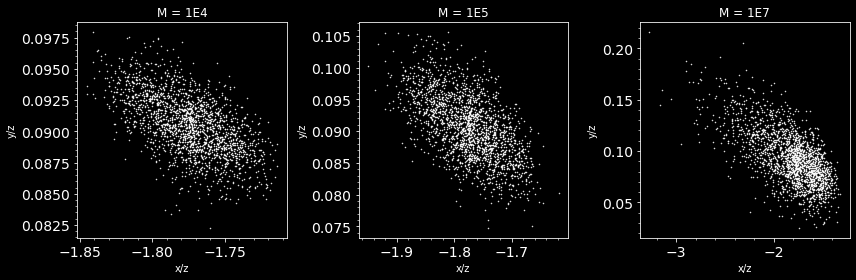

In [13]:
#different masses, same positions 
fig, ax=plt.subplots(figsize=(12, 4), ncols=3)
key_pairs=['stream_pos[   8.3    5.  -700. ]_vel[54. -3.  1.]_mass10000.0',\
           'stream_pos[   8.3    5.  -700. ]_vel[54. -3.  1.]_mass100000.0',\
           'stream_pos[   8.3    5.  -700. ]_vel[54. -3.  1.]_mass10000000.0']
plot_streams([stream_dict[x] for x in key_pairs], ax)

for a in ax:
    a.minorticks_on()
    a.set(xlabel='x/z', ylabel='y/z')
    
ax[0].set(title='M = 1E4')
ax[1].set(title='M = 1E5')
ax[-1].set(title='M = 1E7')
plt.tight_layout()
plt.savefig(path_plot+'/different_mass_stream.pdf')

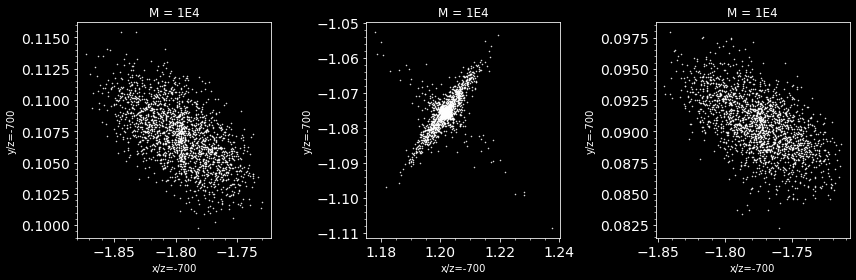

In [14]:
#different masses, same positions 
fig, ax=plt.subplots(figsize=(12, 4), ncols=3)
key_pairs=['stream_pos[   0.   -5. -700.]_vel[54. -3.  1.]_mass10000.0', \
           'stream_pos[ -10.   15. -700.]_vel[-10.   8. 100.]_mass10000.0',\
          'stream_pos[   8.3    5.  -700. ]_vel[54. -3.  1.]_mass10000.0']
plot_streams([stream_dict[x] for x in key_pairs], ax)

for a in ax:
    a.minorticks_on()
    a.set(xlabel='x/z=-700', ylabel='y/z=-700')
    
ax[0].set(title='M = 1E4')
ax[1].set(title='M = 1E4')
ax[-1].set(title='M = 1E4')
plt.tight_layout()
plt.savefig(path_plot+'/same_mass_stream.pdf')

In [15]:
#

In [16]:
good_pos = gd.PhaseSpacePosition(pos=[10, 0, 0.] * u.kpc,
...                                 vel=[0, 170, 0.] * u.km/u.s)
good_pos1 = gd.PhaseSpacePosition(pos=([10, 0, 0.] * u.kpc)+3*u.kpc,
...                                 vel=[0, 170, 0.] * u.km/u.s)
good_pos2 = gd.PhaseSpacePosition(pos=([10, 0, 0.] * u.kpc)-5*u.kpc,
...                                 vel=[0, 170, 0.] * u.km/u.s)

good_pos_fast = gd.PhaseSpacePosition(pos=[10, 0, 0.] * u.kpc,
...                                 vel=np.array([0, -170, 0.]) * 2.*u.km/u.s)
good_pos1_fast = gd.PhaseSpacePosition(pos=([10, 0, 0.] * u.kpc)+3*u.kpc,
...                                 vel=np.array([0, -170, 0.]) * 2*u.km/u.s)
good_pos2_fast = gd.PhaseSpacePosition(pos=([10, 0, 0.] * u.kpc)-5*u.kpc,
...                                 vel=np.array([0, -170, 0.]) * 2*u.km/u.s)

stream0, _=generate_stream(1e4, good_pos )
stream1, _=generate_stream(1e5, good_pos1)
stream2, _=generate_stream(1e6, good_pos2 )

stream3, _=generate_stream(1e4, good_pos_fast)
stream4, _=generate_stream(1e5, good_pos1_fast)
stream5, _=generate_stream(1e6, good_pos2_fast )

In [17]:
from mpl_toolkits.mplot3d import Axes3D
import matplotlib.pyplot as plt
import numpy as np
import matplotlib.animation as animation

In [18]:
Writer = animation.writers['ffmpeg']
writer = Writer(fps=15, metadata=dict(artist='Me'), bitrate=1800)

MovieWriter imagemagick unavailable; using Pillow instead.


Making animation


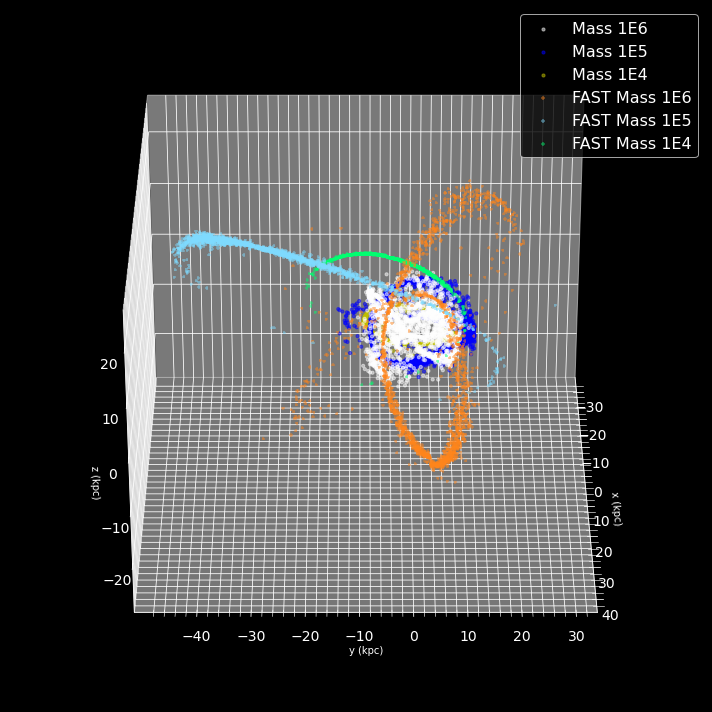

In [19]:
fig=plt.figure(figsize=(10, 10))
ax = plt.axes(projection='3d')




h=ax.scatter(stream2.cartesian.x.value, stream2.cartesian.y.value,\
           stream2.cartesian.z.value, s=10, c='#FFFFFF', label='Mass 1E6', alpha=0.5)
h=ax.scatter(stream1.cartesian.x.value, stream1.cartesian.y.value,\
           stream1.cartesian.z.value, s=10, c='b', label='Mass 1E5', alpha=0.5)
h=ax.scatter(stream0.cartesian.x.value, stream0.cartesian.y.value,\
           stream0.cartesian.z.value, s=10, c='y', label='Mass 1E4', alpha=0.5)




h=ax.scatter(stream5.cartesian.x.value, stream5.cartesian.y.value,\
           stream5.cartesian.z.value, s=10, c='#FF851B', label='FAST Mass 1E6', alpha=0.5, marker='+')
h=ax.scatter(stream4.cartesian.x.value, stream4.cartesian.y.value,\
           stream4.cartesian.z.value, s=10, c='#7FDBFF', label='FAST Mass 1E5', alpha=0.5, marker='+')
h=ax.scatter(stream3.cartesian.x.value, stream3.cartesian.y.value,\
           stream3.cartesian.z.value, s=10, c='#01FF70', label='FAST Mass 1E4', alpha=0.5, marker='+')
ax.minorticks_on()
#ax.grid(False)

ax.set(xlabel='x (kpc)', ylabel='y (kpc)', zlabel='z (kpc)')
ax.legend(fontsize=16)
def rotate(angle):
    ax.view_init(azim=angle)

print("Making animation")
rot_animation = animation.FuncAnimation(fig, rotate, frames=np.arange(0, 362, 2), interval=100)
rot_animation.save(path_plot+'/streams.gif', dpi=80, writer='imagemagick')
#rot_animation.save(path_plot+'/streams.mp4', writer=writer)


plt.tight_layout()
plt.savefig(path_plot+'/different_mass_stream_3d_plot.pdf')

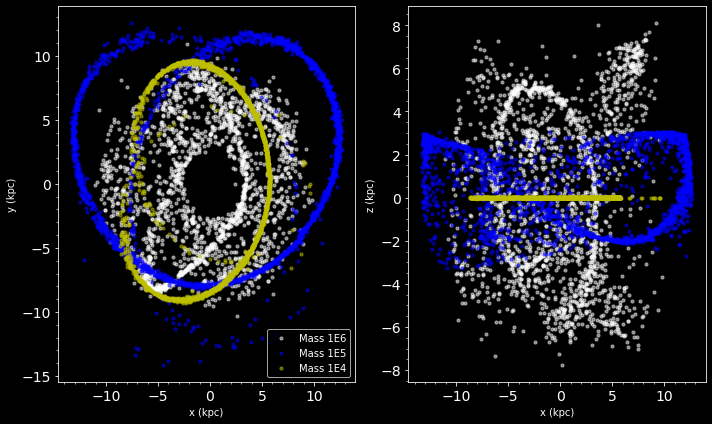

In [20]:
fig, (ax, ax1)=plt.subplots(ncols=2, figsize=(10,6))

h=ax.scatter(stream2.cartesian.x.value, stream2.cartesian.y.value,\
            s=10, c='#FFFFFF', label='Mass 1E6', alpha=0.5)

h=ax.scatter(stream1.cartesian.x.value, stream1.cartesian.y.value,\
            s=10, c='b', label='Mass 1E5', alpha=0.5)

h=ax.scatter(stream0.cartesian.x.value, stream0.cartesian.y.value,\
            s=10, c='y', label='Mass 1E4', alpha=0.5)

h=ax1.scatter(stream2.cartesian.x.value, stream2.cartesian.z.value,\
            s=10, c='#FFFFFF', label='Mass 1E6', alpha=0.5)

h=ax1.scatter(stream1.cartesian.x.value, stream1.cartesian.z.value,\
            s=10, c='b', label='Mass 1E5', alpha=0.5)

h=ax1.scatter(stream0.cartesian.x.value, stream0.cartesian.z.value,\
            s=10, c='y', label='Mass 1E4', alpha=0.5)



ax.legend()
ax.set(xlabel='x (kpc)', ylabel='y (kpc)')
ax1.set(xlabel='x (kpc)', ylabel='z (kpc)')
ax.legend()
plt.tight_layout()
ax.minorticks_on()
ax1.minorticks_on()
plt.savefig(path_plot+'/different_mass_stream_2d_plot.pdf')

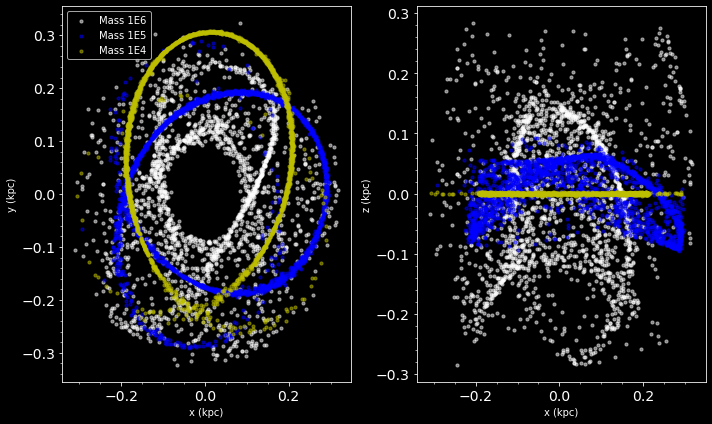

In [21]:
fig, (ax, ax1)=plt.subplots(ncols=2, figsize=(10,6))

h=ax.scatter(stream2.cartesian.v_x.value, stream2.cartesian.v_y.value,\
            s=10, c='#FFFFFF', label='Mass 1E6', alpha=0.5)

h=ax.scatter(stream1.cartesian.v_x.value, stream1.cartesian.v_y.value,\
            s=10, c='b', label='Mass 1E5', alpha=0.5)

h=ax.scatter(stream0.cartesian.v_x.value, stream0.cartesian.v_y.value,\
            s=10, c='y', label='Mass 1E4', alpha=0.5)

h=ax1.scatter(stream2.cartesian.v_x.value, stream2.cartesian.v_z.value,\
            s=10, c='#FFFFFF', label='Mass 1E6', alpha=0.5)

h=ax1.scatter(stream1.cartesian.v_x.value, stream1.cartesian.v_z.value,\
            s=10, c='b', label='Mass 1E5', alpha=0.5)

h=ax1.scatter(stream0.cartesian.v_x.value, stream0.cartesian.v_z.value,\
            s=10, c='y', label='Mass 1E4', alpha=0.5)



ax.legend()
ax.set(xlabel='x (kpc)', ylabel='y (kpc)')
ax1.set(xlabel='x (kpc)', ylabel='z (kpc)')
ax.legend()
plt.tight_layout()
ax.minorticks_on()
ax1.minorticks_on()
plt.savefig(path_plot+'/different_mass_stream_2d_plot_vels.pdf')

In [22]:
massive_streams=[]
small_streams=[]
for t in tqdm(np.logspace(-1, 1, 40)):
    nsteps=1000
    dt=(t/nsteps)*u.Gyr.to(u.Myr)
    
    stream0, _=generate_stream(1e4, good_pos2, dt=dt * u.Myr, nsteps=nsteps)
    stream2, _=generate_stream(1e6, good_pos2 , dt=dt * u.Myr, nsteps=nsteps)
    massive_streams.append(stream0)
    small_streams.append(stream2)

100%|██████████| 40/40 [10:26<00:00, 15.67s/it]


In [23]:
def plot_stream_3d(i):
    fig=plt.figure(figsize=(10, 10))
    ax = plt.axes(projection='3d')
    
    st_sm=massive_streams[i]
    st_bg=small_streams[i]
    
    h=ax.scatter(st_bg.cartesian.x.value,  st_bg.cartesian.y.value,\
                st_bg.cartesian.z.value, s=10, c='y', label='Mass 1E4', alpha=0.5)

    h=ax.scatter(st_sm.cartesian.x.value, st_sm.cartesian.y.value,\
               st_sm.cartesian.z.value, s=10, c='#FFFFFF', label='Mass 1E6', alpha=0.5)
    
    ax.minorticks_on()
    
    # IMPORTANT ANIMATION CODE HERE
    # Used to keep the limits constant
    ax.set(xlabel='x (kpc)', ylabel='y (kpc)', zlabel='z (kpc)')

    # Used to return the plot as an image rray
    fig.canvas.draw()       # draw the canvas, cache the renderer
    image = np.frombuffer(fig.canvas.tostring_rgb(), dtype='uint8')
    image  = image.reshape(fig.canvas.get_width_height()[::-1] + (3,))

    return image

In [24]:
def plot_energy(i):
    
    fig,  ax=plt.subplots(ncols=3, figsize=(12, 4))
    
    fig.suptitle('T = {} Gyr'.format(np.round(np.logspace(-1, 1, 40)[i], 1)), fontsize=16)

    st_sm=massive_streams[i]
    st_bg=small_streams[i]
    
    ax[0].scatter(st_bg.angular_momentum()[0].value,  st_bg.energy(H).value,\
               c='y',  s=1,  label='Mass 1E6', alpha=0.5)
    ax[0].scatter(st_sm.angular_momentum()[0].value,  st_sm.energy(H).value,\
               c='#FFFFFF', s=1,  label='Mass 1E6', alpha=0.5)
    
    ax[1].scatter(st_bg.angular_momentum()[1].value,  st_bg.energy(H).value,\
               c='y',  s=1,  label='Mass 1E6', alpha=0.5)
    ax[1].scatter(st_sm.angular_momentum()[1].value,  st_sm.energy(H).value,\
               c='#FFFFFF', s=1,  label='Mass 1E6', alpha=0.5)
    
    ax[-1].scatter(st_bg.angular_momentum()[-1].value,  st_bg.energy(H).value,\
               c='y',  s=1,  label='Mass 1E6', alpha=0.5)
    ax[-1].scatter(st_sm.angular_momentum()[-1].value,  st_sm.energy(H).value,\
               c='#FFFFFF', s=1,  label='Mass 1E6', alpha=0.5)
    
    ax[0].set(xlabel='Lx', ylabel='Energy')
    ax[1].set(xlabel='Ly', ylabel='Energy')
    ax[-1].set(xlabel='Lz', ylabel='Energy')
    
    plt.tight_layout()
    
    # Used to return the plot as an image rray
    fig.canvas.draw()       # draw the canvas, cache the renderer
    image = np.frombuffer(fig.canvas.tostring_rgb(), dtype='uint8')
    image  = image.reshape(fig.canvas.get_width_height()[::-1] + (3,))

    
    return image

In [25]:
def plot_phase_stream(i):
    fig,  ax=plt.subplots(ncols=3, nrows=2, figsize=(12, 6))
    
    fig.suptitle('T = {} Gyr'.format(np.round(np.logspace(-1, 1, 40)[i], 1)), fontsize=16)

    st_sm=massive_streams[i]
    st_bg=small_streams[i]

    h=ax[0][0].scatter(st_bg.cartesian.x.value, st_bg.cartesian.v_x.to(u.km/u.s).value,\
                s=1, c='y', label='Mass 1E5', alpha=0.5)
        
    h=ax[0][0].scatter(st_sm.cartesian.x.value, st_sm.cartesian.v_x.to(u.km/u.s).value,\
                s=1, c='#FFFFFF', label='Mass 1E6', alpha=0.5)


    h=ax[0][1].scatter(st_bg.cartesian.y.value, st_bg.cartesian.v_y.to(u.km/u.s).value,\
                s=1, c='y', label='Mass 1E5', alpha=0.5)
    
    h=ax[0][1].scatter(st_sm.cartesian.y.value, st_sm.cartesian.v_y.to(u.km/u.s).value,\
                s=1, c='#FFFFFF', label='Mass 1E6', alpha=0.5)

    
    h=ax[0][-1].scatter(st_bg.cartesian.z.value, st_bg.cartesian.v_z.to(u.km/u.s).value,\
                s=1, c='y', label='Mass 1E5', alpha=0.5)
    
    h=ax[0][-1].scatter(st_sm.cartesian.z.value, st_sm.cartesian.v_z.to(u.km/u.s).value,\
                s=1, c='#FFFFFF', label='Mass 1E6', alpha=0.5)
    
    
    h=ax[1][0].scatter( st_bg.cartesian.x.value, st_bg.angular_momentum()[0].value,\
                s=1, c='y', label='Mass 1E5', alpha=0.5)
    
    h=ax[1][0].scatter(st_sm.cartesian.x.value, st_sm.angular_momentum()[0].value,\
                s=1, c='#FFFFFF', label='Mass 1E6', alpha=0.5)
    
    h=ax[1][1].scatter( st_bg.cartesian.y.value, st_bg.angular_momentum()[1].value,\
                s=1, c='y', label='Mass 1E5', alpha=0.5)
    
    h=ax[1][1].scatter(st_sm.cartesian.y.value, st_sm.angular_momentum()[1].value,\
                s=1, c='#FFFFFF', label='Mass 1E6', alpha=0.5)
    
    h=ax[1][-1].scatter( st_bg.cartesian.z.value, st_bg.angular_momentum()[-1].value,\
                s=1, c='y', label='Mass 1E5', alpha=0.5)
    
    h=ax[1][-1].scatter(st_sm.cartesian.z.value, st_sm.angular_momentum()[-1].value,\
                s=1, c='#FFFFFF', label='Mass 1E6', alpha=0.5)
    


  
    
    ax[0][0].set(xlabel='x (kpc)', ylabel='vx (km/s)')
    ax[0][1].set(xlabel='y (kpc)', ylabel='vy (km/s)')
    ax[0][-1].set(xlabel='z (kpc)', ylabel='vz (km/s)')
    
    ax[1][0].set(xlabel='x (kpc)', ylabel='Lx')
    ax[1][1].set(xlabel='y (kpc)', ylabel='Ly')
    ax[1][-1].set(xlabel='z (kpc)', ylabel='Lz')
    plt.tight_layout()
    
    # IMPORTANT ANIMATION CODE HERE
    # Used to keep the limits constant

    # Used to return the plot as an image rray
    fig.canvas.draw()       # draw the canvas, cache the renderer
    image = np.frombuffer(fig.canvas.tostring_rgb(), dtype='uint8')
    image  = image.reshape(fig.canvas.get_width_height()[::-1] + (3,))

    return image

In [26]:
def plot_stream(i):
    fig,  ax=plt.subplots(ncols=3, nrows=2, figsize=(12, 6))
    
    fig.suptitle('T = {} Gyr'.format(np.round(np.logspace(-1, 1, 40)[i], 1)), fontsize=16)

    st_sm=massive_streams[i]
    st_bg=small_streams[i]

    h=ax[0][0].scatter(st_bg.cartesian.x.value, st_bg.cartesian.y.value,\
                s=1, c='y', label='Mass 1E5', alpha=0.5)
        
    h=ax[0][0].scatter(st_sm.cartesian.x.value, st_sm.cartesian.y.value,\
                s=1, c='#FFFFFF', label='Mass 1E6', alpha=0.5)


    h=ax[1][0].scatter(st_bg.cartesian.v_x.to(u.km/u.s).value, st_bg.cartesian.v_y.to(u.km/u.s).value,\
                s=1, c='y', label='Mass 1E5', alpha=0.5)
    
    h=ax[1][0].scatter(st_sm.cartesian.v_x.to(u.km/u.s).value, st_sm.cartesian.v_y.to(u.km/u.s).value,\
                s=1, c='#FFFFFF', label='Mass 1E6', alpha=0.5)


    h=ax[0][1].scatter(st_bg.cartesian.x.value, st_bg.cartesian.z.value,\
                s=1, c='y', label='Mass 1E5', alpha=0.5)

    h=ax[0][1].scatter(st_sm.cartesian.x.value, st_sm.cartesian.z.value,\
                s=1, c='#FFFFFF', label='Mass 1E6', alpha=0.5)
    
    
    h=ax[1][1].scatter(st_bg.cartesian.v_x.to(u.km/u.s).value, st_bg.cartesian.v_z.to(u.km/u.s).value,\
                s=1, c='y', label='Mass 1E5', alpha=0.5)
    
    h=ax[1][1].scatter(st_sm.cartesian.v_x.to(u.km/u.s).value, st_sm.cartesian.v_z.to(u.km/u.s).value,\
                s=1, c='#FFFFFF', label='Mass 1E6', alpha=0.5)
    
    
    h=ax[0][-1].scatter((st_bg.cartesian.x.value**2+st_bg.cartesian.y.value**2)**0.5, \
                        st_bg.cartesian.v_z.to(u.km/u.s).value,\
                s=1, c='y', label='Mass 1E5', alpha=0.5)
        
    h=ax[0][-1].scatter((st_sm.cartesian.x.value**2+st_sm.cartesian.y.value**2)**0.5, \
                        st_sm.cartesian.v_z.to(u.km/u.s).value,\
                s=1, c='#FFFFFF', label='Mass 1E6', alpha=0.5)

    h=ax[1][-1].scatter(((st_bg.cartesian.v_x**2+st_bg.cartesian.v_y**2)**0.5).to(u.km/u.s).value,  \
                        st_bg.cartesian.v_z.to(u.km/u.s).value,\
                s=1, c='y', label='Mass 1E5', alpha=0.5)
    

    h=ax[1][-1].scatter(((st_sm.cartesian.v_x**2+st_sm.cartesian.v_y**2)**0.5).to(u.km/u.s).value, \
                        st_sm.cartesian.v_z.to(u.km/u.s).value,\
                s=1, c='#FFFFFF', label='Mass 1E6', alpha=0.5)

  
    
    ax[0][0].set(xlabel='x (kpc)', ylabel='y (kpc)')
    ax[0][1].set(xlabel='x (kpc)', ylabel='z (kpc)')
    ax[0][-1].set(xlabel='r (kpc)', ylabel='z (kpc)')
    
    ax[1][0].set(xlabel='vx (km/s)', ylabel='vy (km/s)')
    ax[1][1].set(xlabel='vx (km/s)', ylabel='vz (km/s)')
    ax[1][-1].set(xlabel='vr (km/s)', ylabel='vz (km/s)')
    plt.tight_layout()
    
    # IMPORTANT ANIMATION CODE HERE
    # Used to keep the limits constant

    # Used to return the plot as an image rray
    fig.canvas.draw()       # draw the canvas, cache the renderer
    image = np.frombuffer(fig.canvas.tostring_rgb(), dtype='uint8')
    image  = image.reshape(fig.canvas.get_width_height()[::-1] + (3,))

    return image

In [27]:
import imageio

<ipython-input-26-cca5363b36a9>:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig,  ax=plt.subplots(ncols=3, nrows=2, figsize=(12, 6))



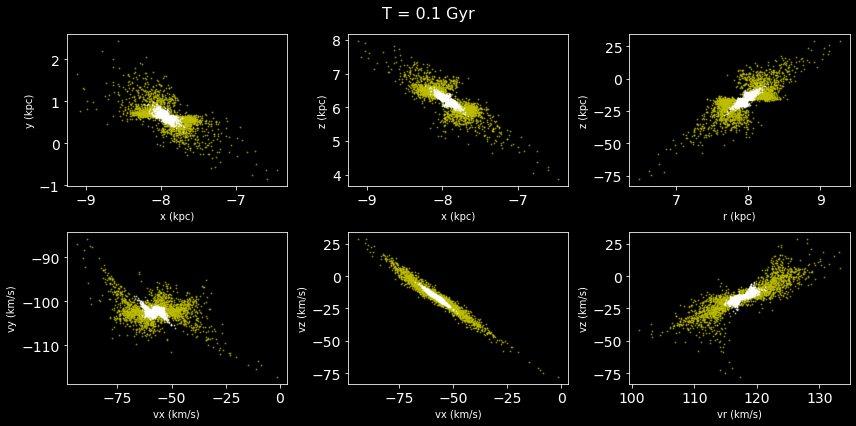

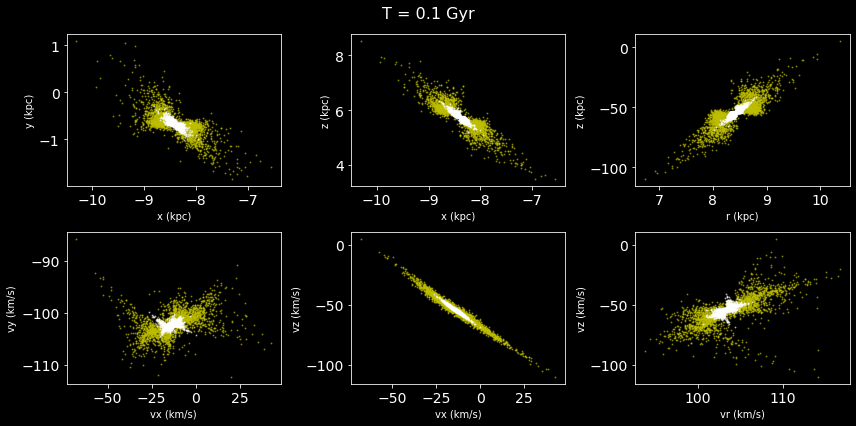

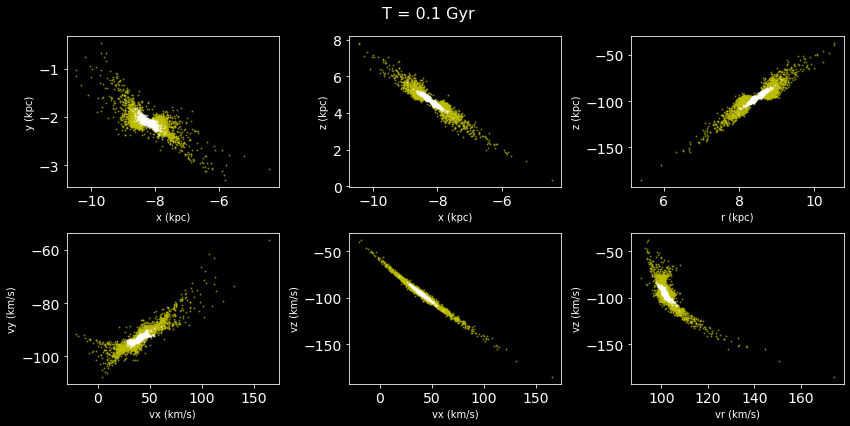

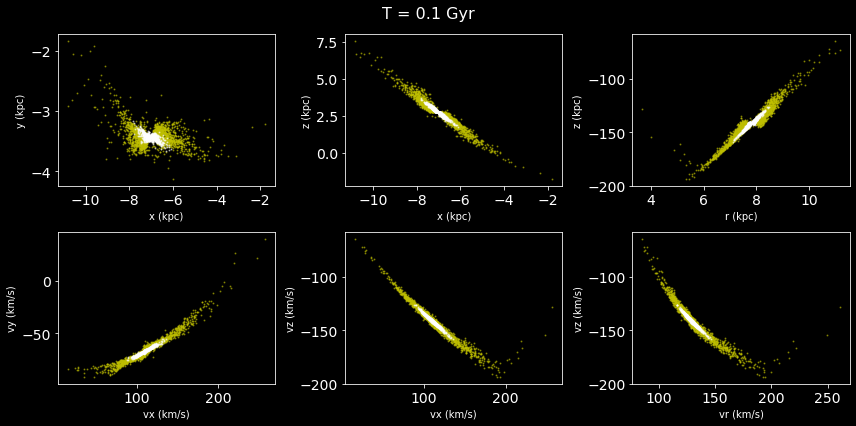

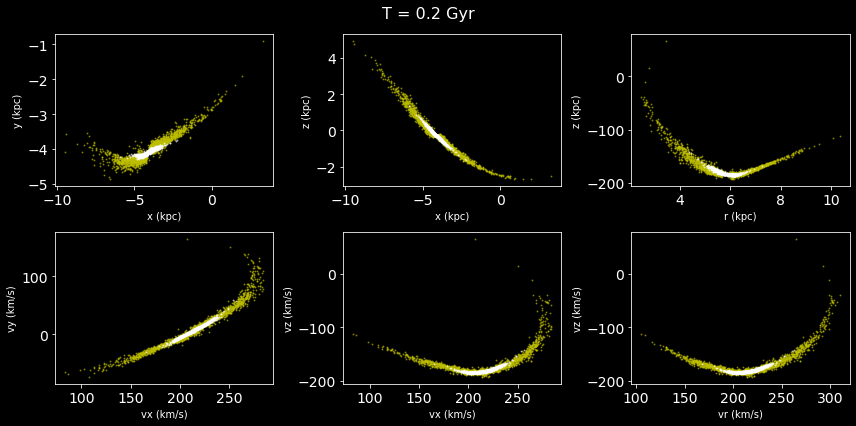

...

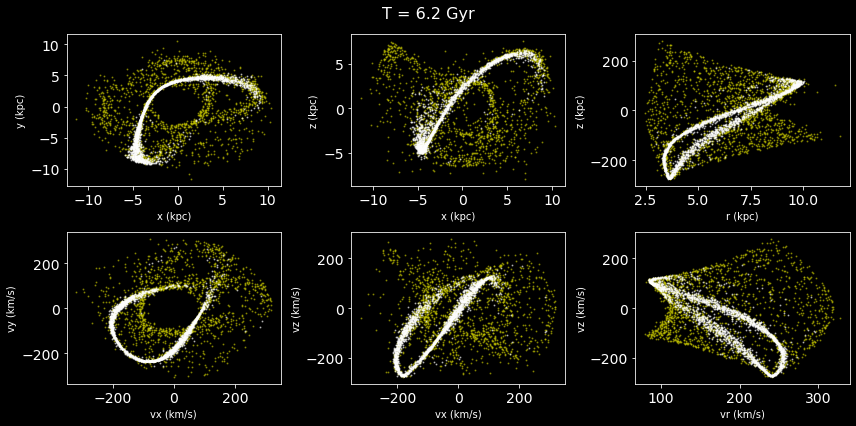

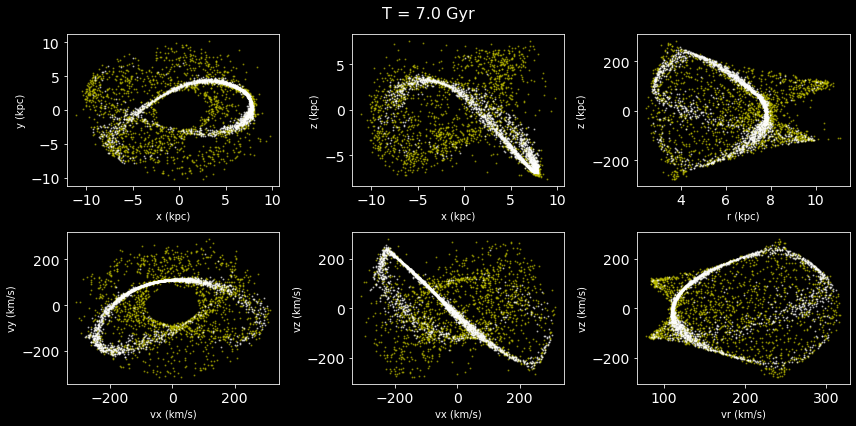

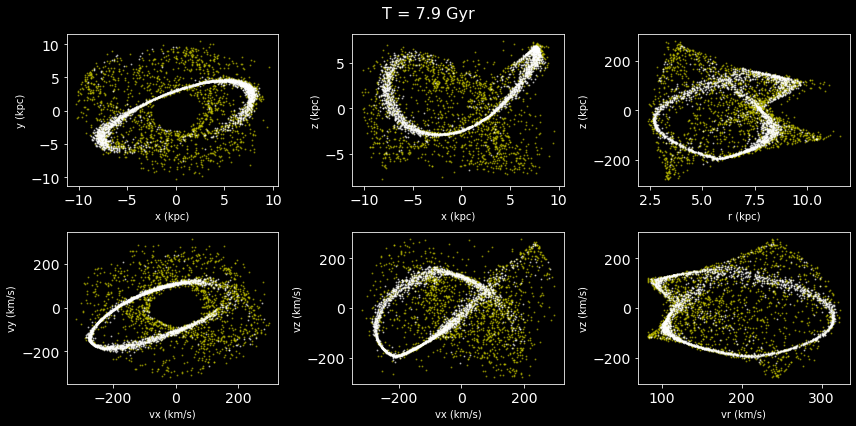

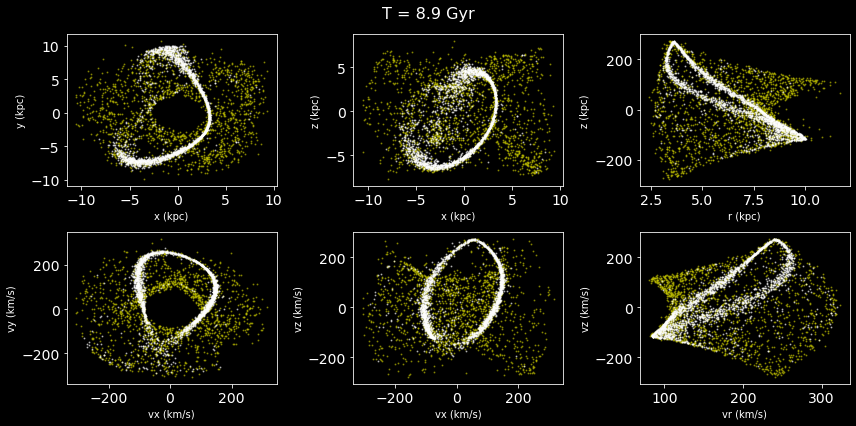

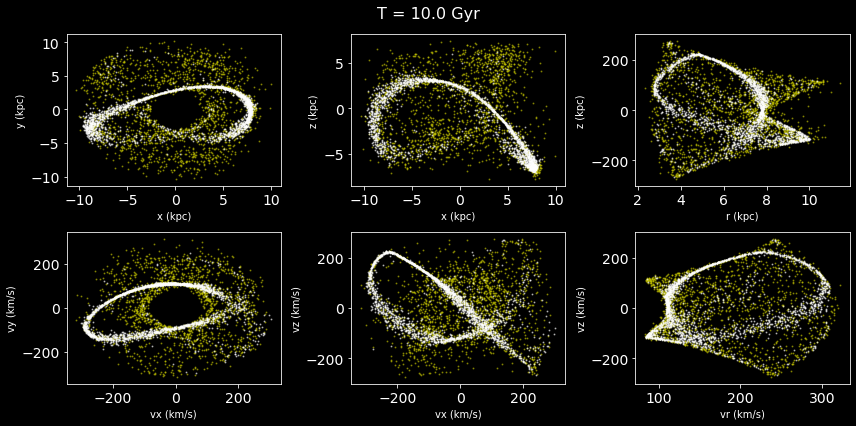

In [36]:
kwargs_write = {'fps':10.0, 'quantizer':'nq'}
imageio.mimsave(path_plot+'/animated_vel_pos.gif', [ plot_stream(i) for i in range(40)], fps=10)

<ipython-input-25-f499d5808820>:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig,  ax=plt.subplots(ncols=3, nrows=2, figsize=(12, 6))



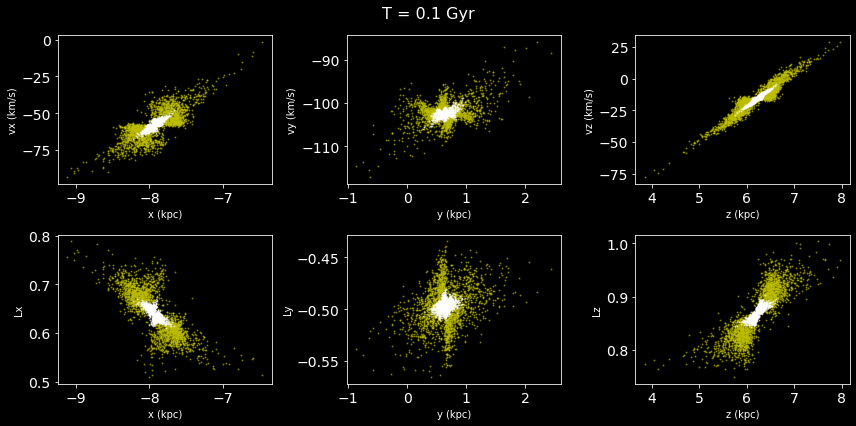

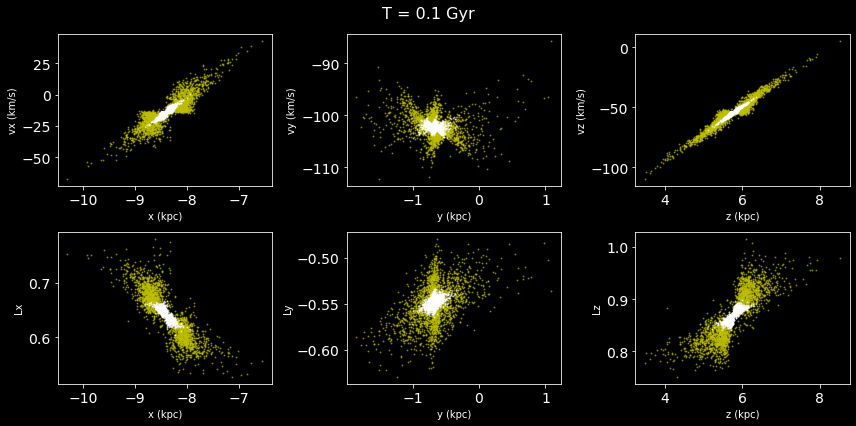

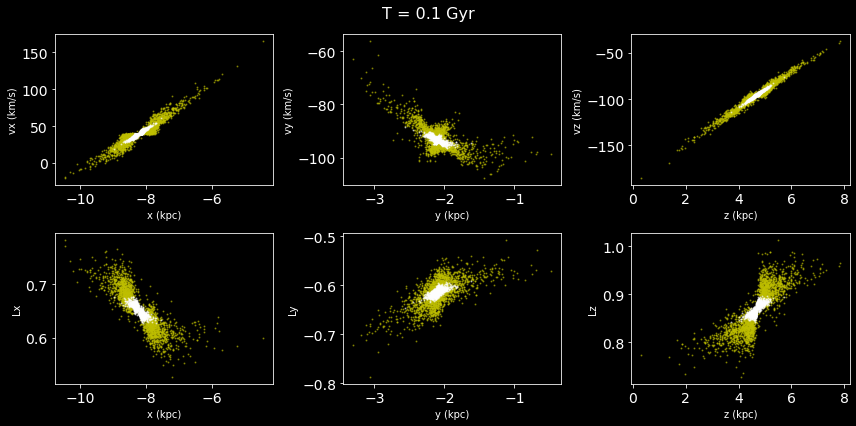

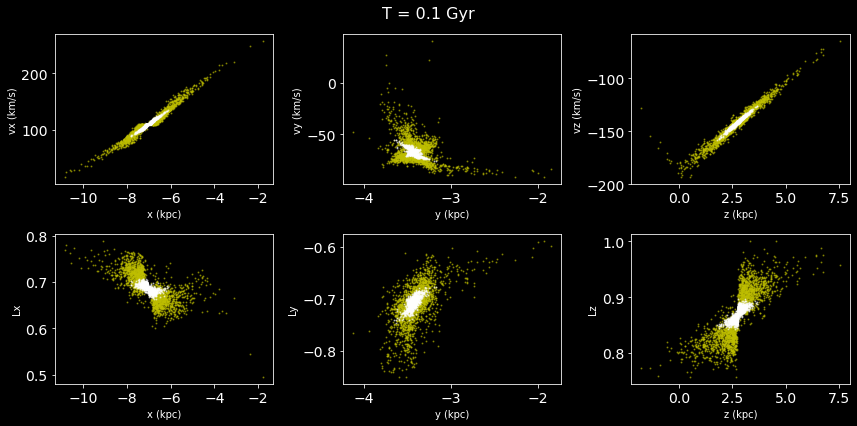

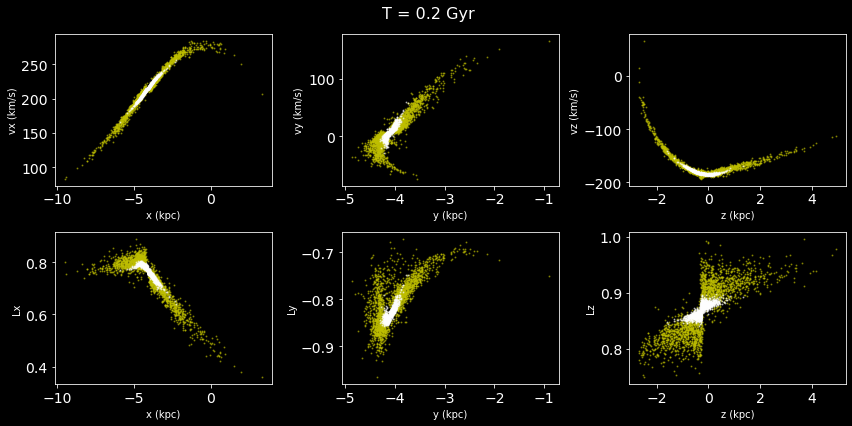

...

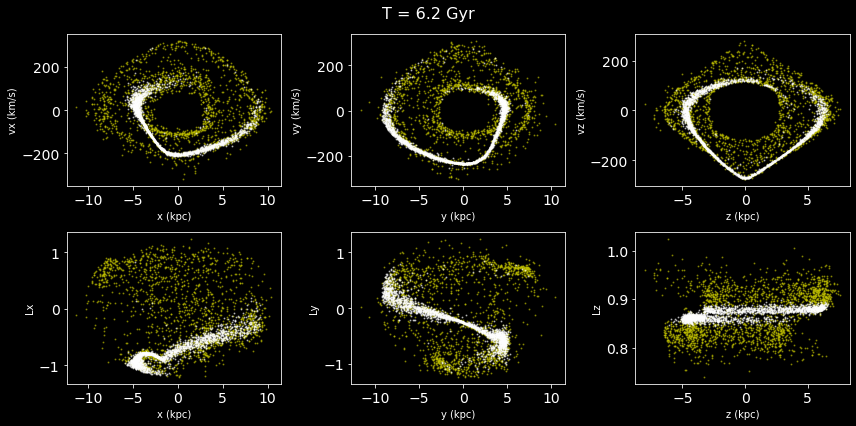

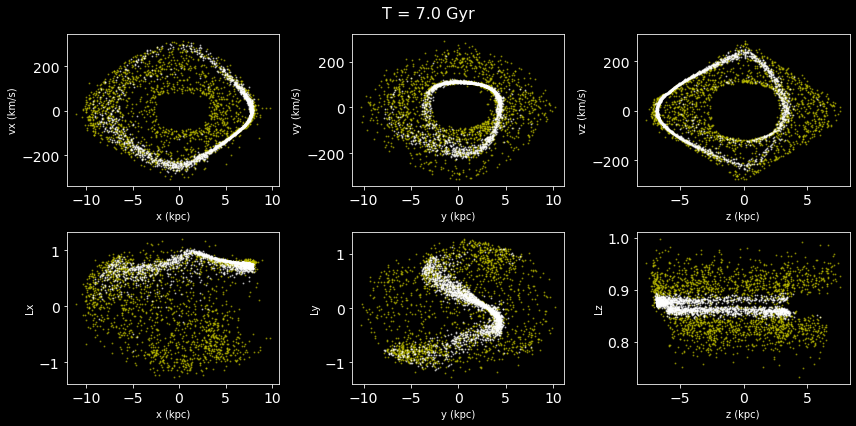

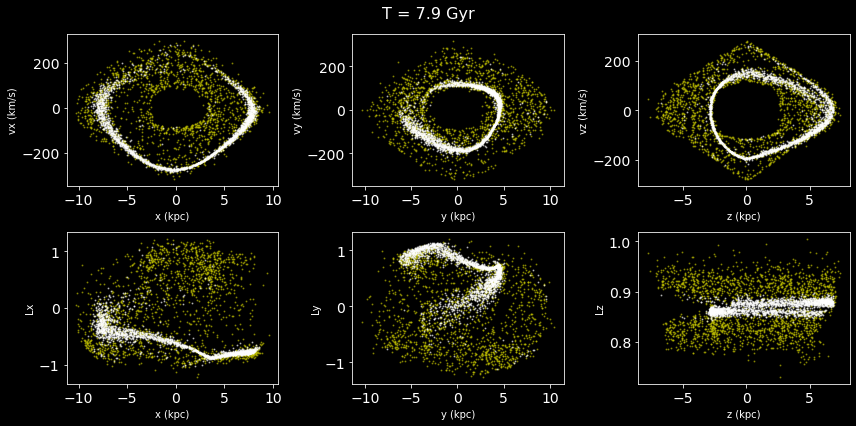

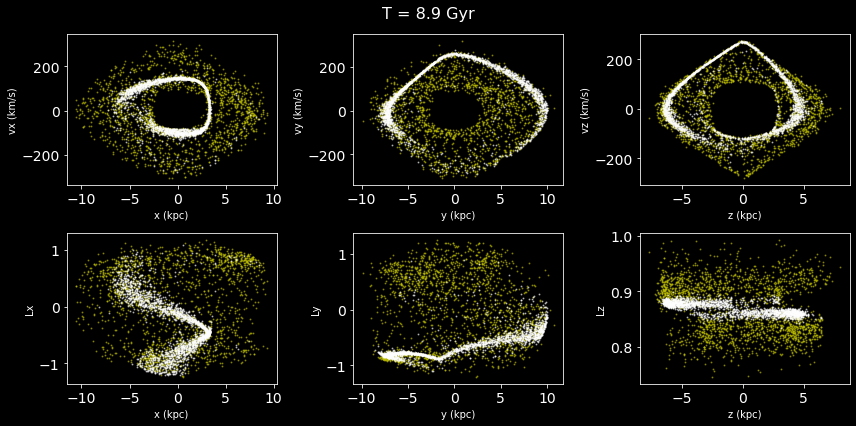

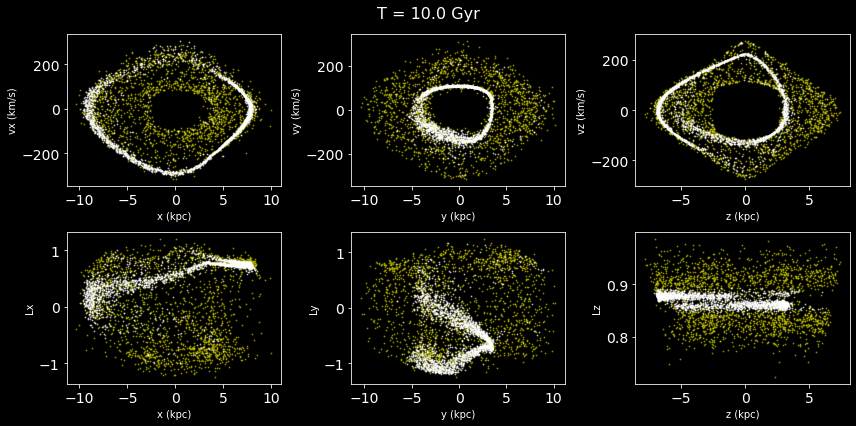

In [37]:
kwargs_write = {'fps':10.0, 'quantizer':'nq'}
imageio.mimsave(path_plot+'/animated_vel_phase_space.gif', [  plot_phase_stream(i) for i in range(40)], fps=10)

<ipython-input-23-16a2bcc5d16f>:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig=plt.figure(figsize=(10, 10))



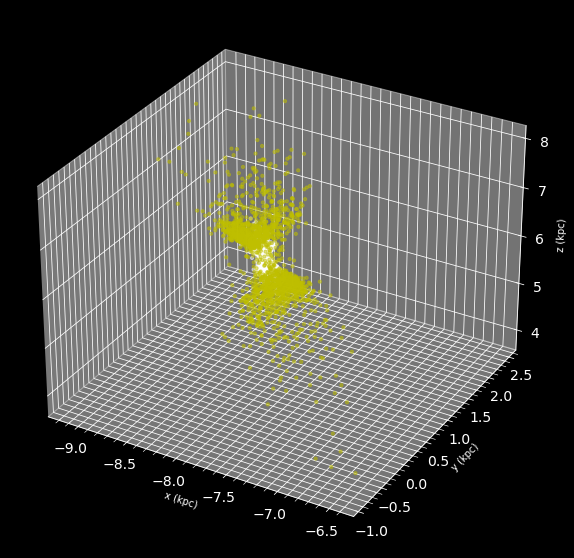

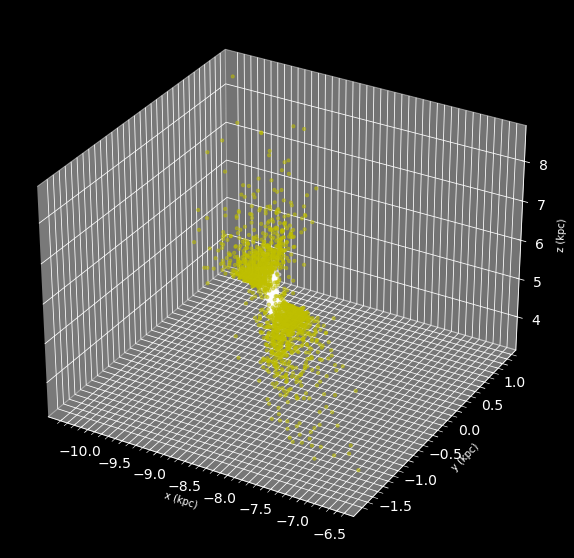

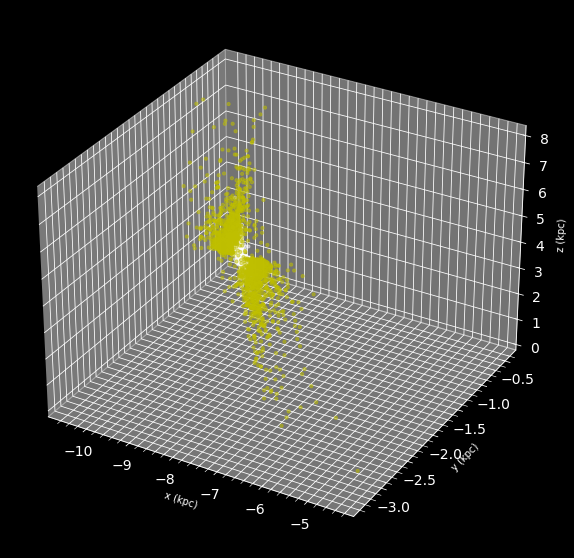

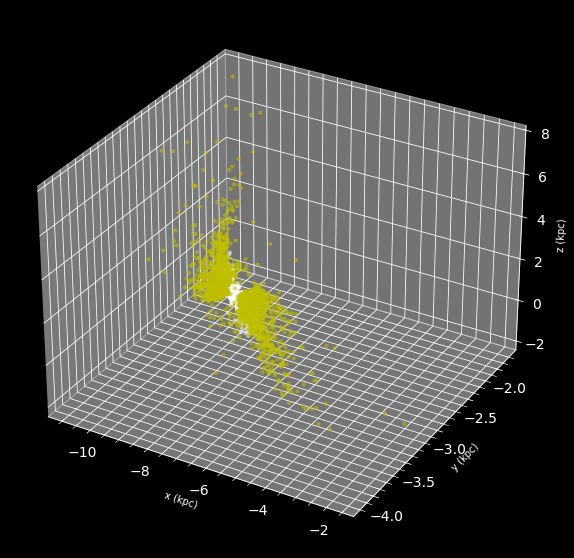

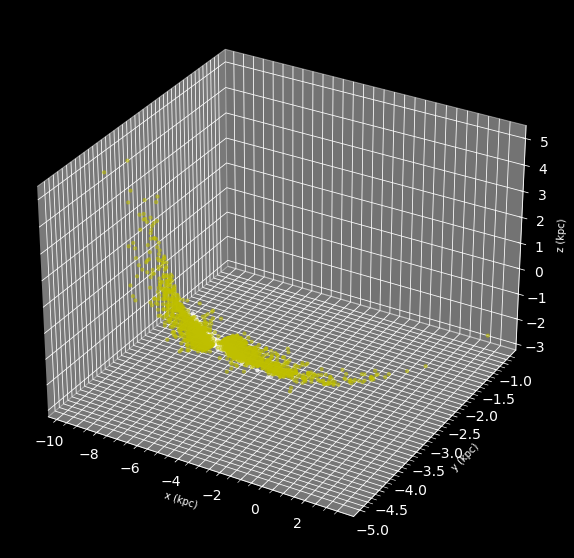

...

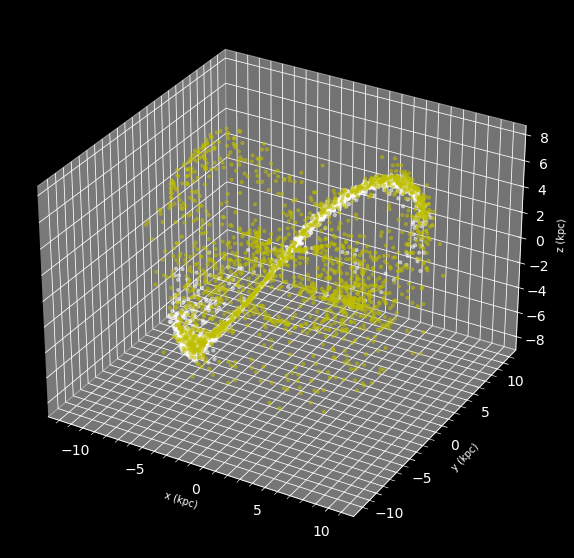

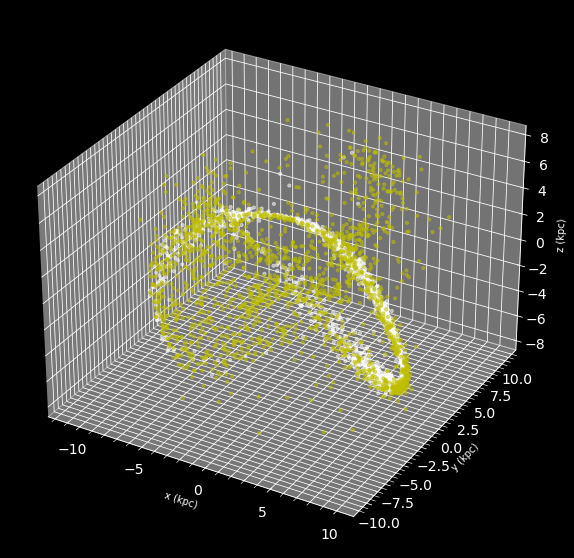

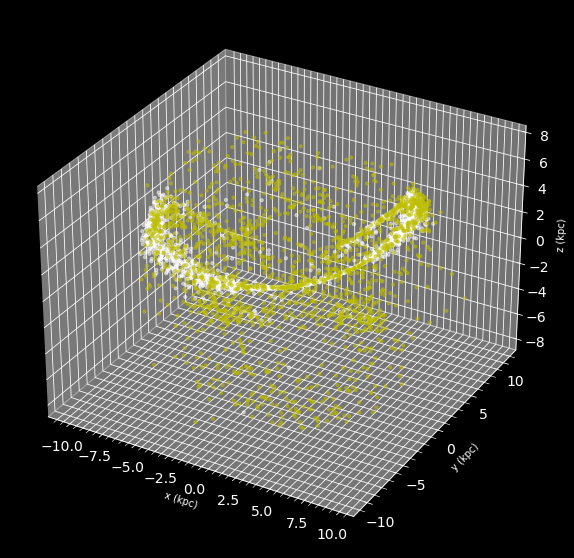

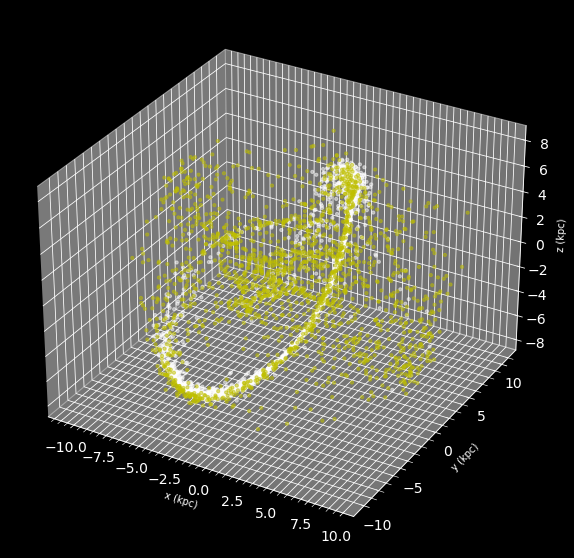

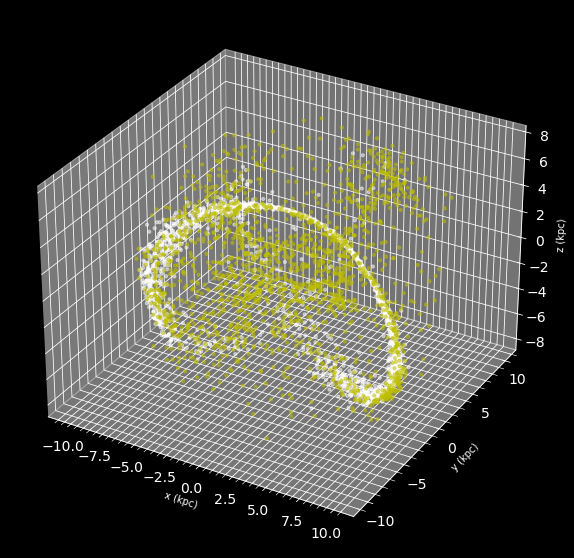

In [38]:
kwargs_write = {'fps':10.0, 'quantizer':'nq'}
imageio.mimsave(path_plot+'/animated_pos_3d.gif', [ plot_stream_3d(i) for i in range(40)], fps=10)

<ipython-input-24-7e1f7d42ef0d>:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig,  ax=plt.subplots(ncols=3, figsize=(12, 4))



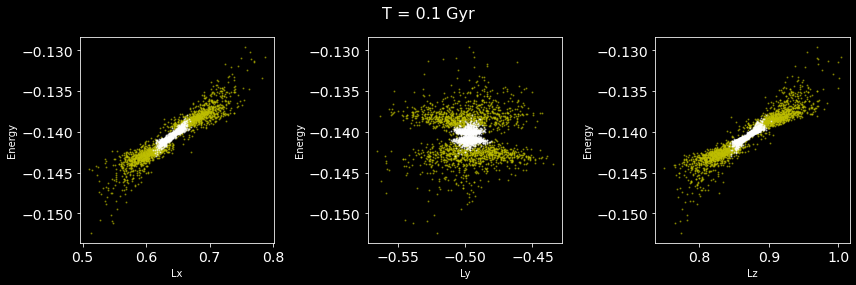

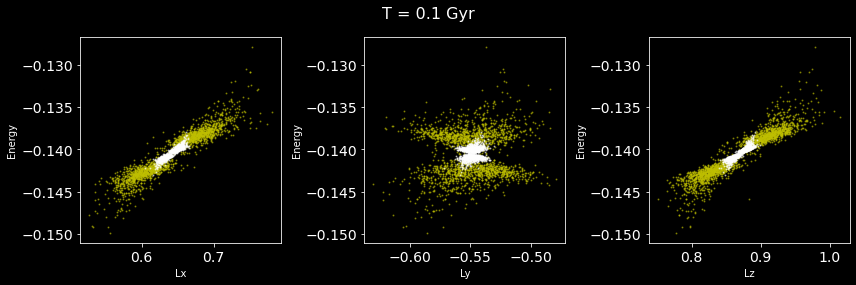

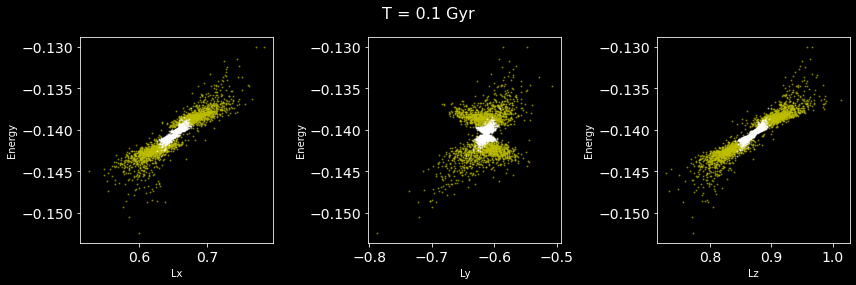

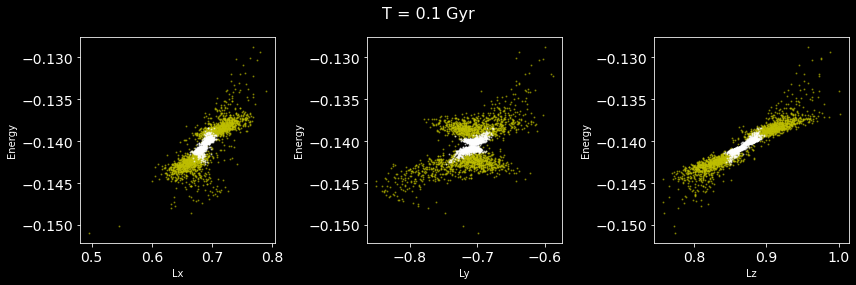

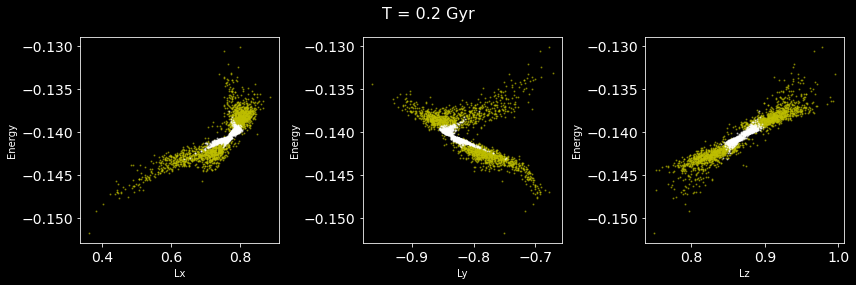

...

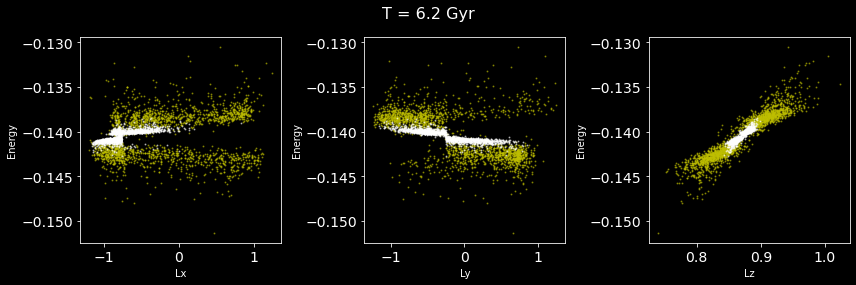

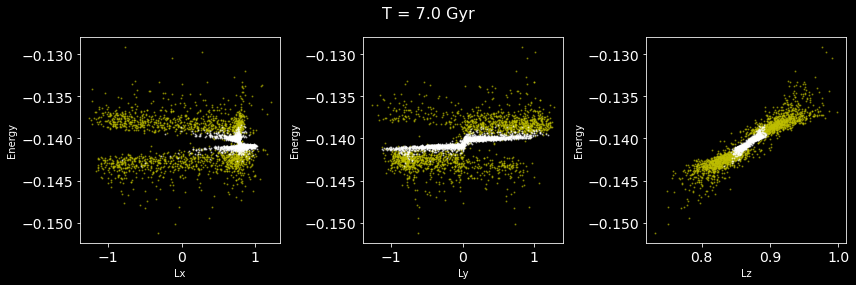

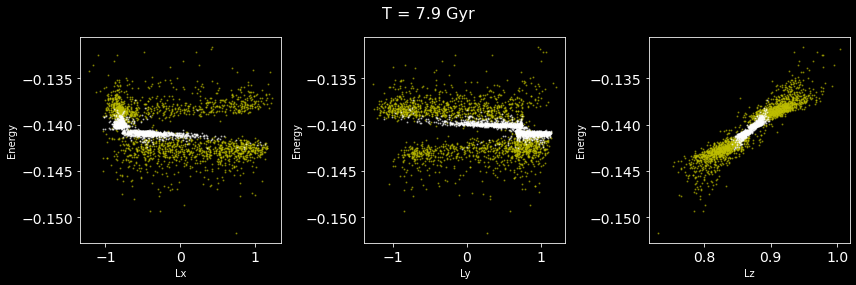

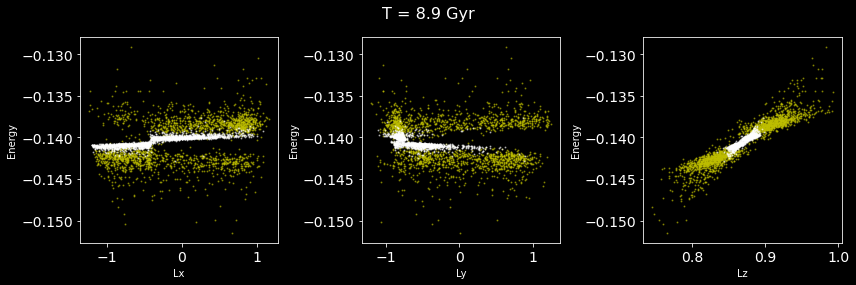

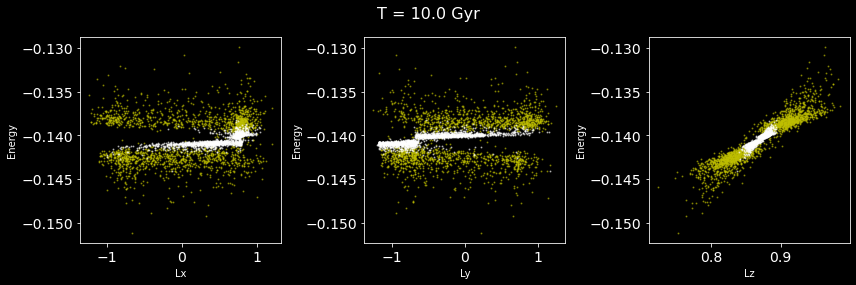

In [39]:
kwargs_write = {'fps':10.0, 'quantizer':'nq'}
imageio.mimsave(path_plot+'/animated_energy_momentum.gif', [ plot_energy(i) for i in range(40)], fps=10)